In [1]:
from scipy import *
from numpy import *
from matplotlib.pyplot import *
from matplotlib.animation import FuncAnimation
from scipy.linalg import *
from numpy.linalg import *
import scipy.sparse as sp
from scipy.sparse.linalg import spsolve
from scipy.integrate import solve_ivp
import FNC

In [2]:
# This (optional) block is for improving the display of plots.
from IPython.display import set_matplotlib_formats
set_matplotlib_formats("svg","pdf")
rcParams["figure.figsize"] = [7,4]
rcParams["lines.linewidth"] = 2
rcParams["lines.markersize"] = 4
rcParams['animation.html'] = "jshtml"  # or try "html5"

# Example 12.1.1

We solve the advection equation on a domain with periodic end conditions. Our approach is the method of lines.

In [3]:
x,Dx,Dxx = FNC.diffper(300,[-4,4])
f = lambda t,u: -c*(Dx@u)

The following initial condition isn't mathematically periodic, but the deviation is less than machine precision. We specify RK4 as the solver.  

In [4]:
u_init = 1 + exp(-3*x**2)
c = 2
sol = solve_ivp(f,[0,3.],u_init,method="Radau",dense_output=True)

An animation shows the solution nicely. The bump moves with speed 2 to the right, reentering on the left as it exits to the right because of the periodic conditions. 

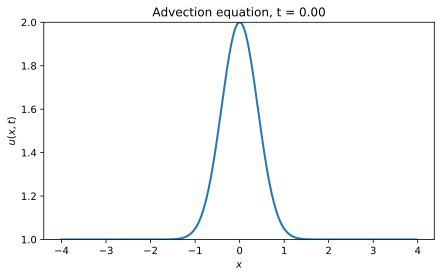

In [5]:
fig,ax = subplots()
curve = ax.plot(x,u_init)[0]
ax.set_xlabel("$x$"); ax.set_ylabel("$u(x,t)$");
ax.set_ylim(1,2)
ax.set_title("Advection equation");

t = linspace(0,3,201)
def snapshot(j):
    curve.set_ydata(sol.sol(t[j]))
    ax.set_title(f"Advection equation, t = {t[j]:.2f}")
FuncAnimation(fig,snapshot,frames=len(t))

# Example 12.1.2

We solve for traffic flow using periodic boundary conditions. The following are parameters and a function relevant to defining the problem. 

In [6]:
rho_c = 1080;  rho_m = 380;  q_m = 10000;
Q0prime = lambda rho: q_m*4*rho_c**2*(rho_c-rho_m)*rho_m*(rho_m-rho)/(rho*(rho_c-2*rho_m) + rho_c*rho_m)**3

Here we create a discretization on $m=800$ points.

In [7]:
x,Dx,Dxx = FNC.diffper(800,[0,4])

Next we define the ODE resulting from the method of lines.

In [8]:
ode = lambda t,rho: -Q0prime(rho)*(Dx@rho) + ep*(Dxx@rho)

Our first initial condition has moderate density with a small bump.

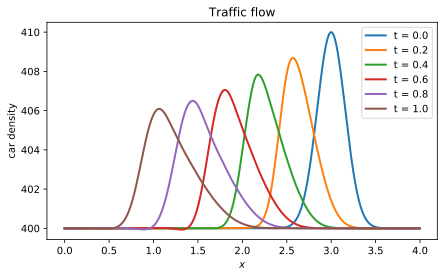

In [9]:
rho_init =  400 + 10*exp(-20*(x-3)**2)
ep = 0.02
sol = solve_ivp(ode,[0,1.],rho_init,method="Radau",dense_output=True)
for t in linspace(0,1,6):
    plot(x,sol.sol(t),label=f"t = {t:.1f}")

xlabel("$x$"); ylabel("car density"); 
legend(); title("Traffic flow");     

The bump slowly moves backward on the roadway, spreading out and gradually fading away due to the presence of diffusion.

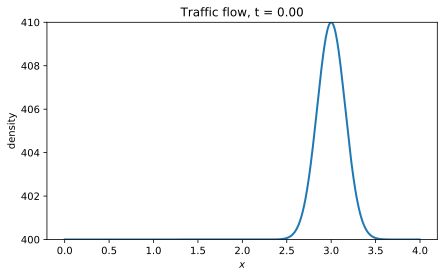

In [10]:
fig,ax = subplots()
curve = ax.plot(x,rho_init)[0];
ax.set_xlabel("$x$"); ax.set_ylabel("density");
ax.set_ylim(400,410);
ax.set_title("Traffic flow");

t = linspace(0,1,101)
def snapshot(j):
    curve.set_ydata(sol.sol(t[j]))
    ax.set_title(f"Traffic flow, t = {t[j]:.2f}")
FuncAnimation(fig,snapshot,frames=len(t))

Now we use an initial condition with a larger bump. 

In [11]:
rho_init = 400 + 80*exp(-16*(x-3)**2)
sol = solve_ivp(ode,[0,0.5],rho_init,method="Radau",dense_output=True)

In [12]:
ax.set_ylim(400,480)
t = linspace(0,0.5,101)
def snapshot(j):
    curve.set_ydata(sol.sol(t[j]))
    ax.set_title(f"Traffic flow, t = {t[j]:.2f}")
FuncAnimation(fig,snapshot,frames=len(t))

In this case the density bump travels backward along the road. It also steepens on the side facing the incoming traffic and decreases much more slowly on the other side. A motorist would experience this as an abrupt increase in density, followed by a much more gradual decrease in density and resulting gradual increase in speed. 

# Example 12.2.1

We set up a test problem with velocity $c=2$ and periodic end conditions. 

In [13]:
x,Dx,Dxx = FNC.diffper(400,[0,1])
uinit = exp(-80*(x-0.5)**2)

For this problem we use `RK4`, an explicit method. 

In [14]:
c = 2
ode = lambda t,u: -c*(Dx@u)
sol = solve_ivp(ode,(0,2),uinit,method="RK45",dense_output=True)

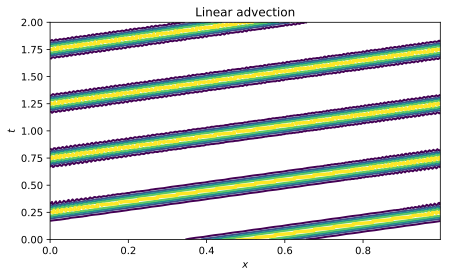

In [15]:
t = linspace(0,2,81)
u = vstack([sol.sol(tj) for tj in t])
contour(x,t,u,levels=arange(0.15,1.0,0.2))
xlabel("$x$"); ylabel("$t$"); 
title("Linear advection");

You can see the hump traveling rightward at constant speed, traversing the domain once for each integer multiple of $t=1/2$. We note the average time step that was chosen:

In [16]:
avgtau1 = sum(diff(sol.t))/(len(sol.t)-1)
print(avgtau1)

0.0014388489208633094


We cut $h$ by a factor of two and solve again.

In [17]:
x,Dx,Dxx = FNC.diffper(800,[0,1])
uinit = exp(-80*(x-0.5)**2);
sol = solve_ivp(ode,(0,2),uinit,method="RK45",dense_output=True)

The CFL condition suggests that the time step should be cut by a factor of two also.

In [18]:
avgtau2 = sum(diff(sol.t))/(len(sol.t)-1)
print("step size ratio:",avgtau1/avgtau2)

step size ratio: 2.0553956834532374


# Example 12.2.2

We set up advection over $[0,1]$ with velocity $c=-1$. This puts the right-side boundary in the upwind direction.

In [19]:
n = 100
x,Dx,Dxx = FNC.diffmat2(n,[0,1])
uinit = exp(-80*(x-0.5)**2)

First we try imposing $u=0$ at the right boundary, by appending that value to the end of the vector before multiplying by the differentiation matrix.

In [20]:
trunc = lambda u: u[:-1];  extend = lambda v: hstack([v,0])
ode = lambda t,v: -c*trunc(Dx@extend(v))
c = -1
sol = solve_ivp(ode,(0,1),trunc(uinit),method="RK45",dense_output=True)

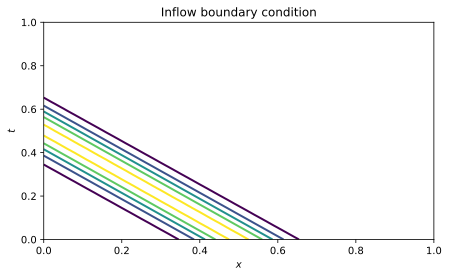

In [21]:
t = linspace(0,1,80)
U = [ extend(sol.sol(tj)) for tj in t ]
contour(x,t,U,levels=arange(0.15,1.0,0.2))
xlabel("$x$"); ylabel("$t$"); 
title("Inflow boundary condition");

The data from the initial condition propagates out of the left edge. Because only zero is coming in from the upwind direction, the solution remains zero thereafter.

Now we try $u=0$ imposed at the left boundary. 

In [22]:
trunc = lambda u: u[1:];  extend = lambda v: hstack([0,v]);
sol = solve_ivp(ode,(0,1),trunc(uinit),method="RK45",dense_output=True)

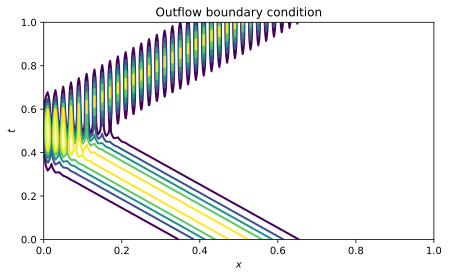

In [23]:
U = [ extend(sol.sol(tj)) for tj in t ]
contour(x,t,U,levels=arange(0.15,1.0,0.2))
xlabel("$x$"); ylabel("$t$"); 
title("Outflow boundary condition");

Everything seems OK until the data begins to interact with the inappropriate boundary condition. The resulting "reflection" is entirely wrong for advection from right to left. 

# Example 12.3.1

For $c=1$ we get the eigenvalues:

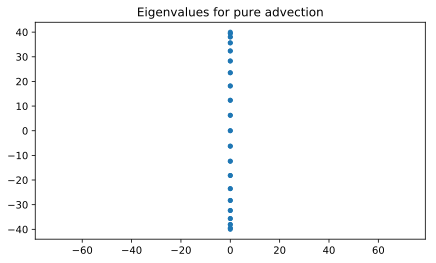

In [24]:
x,Dx,Dxx = FNC.diffper(40,[0,1])
lamb = eigvals(Dx);

plot(real(lamb),imag(lamb),"o")
axis([-40,40,-40,40]); axis("equal");
title("Eigenvalues for pure advection");     

Let's choose a time step of $\tau=0.1$ and compare to the stability regions of the Euler and backward Euler time steppers.

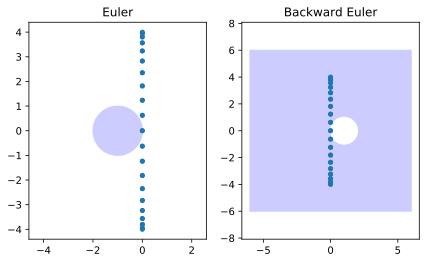

In [25]:
zc = exp(2j*pi*arange(361)/360);    # points on |z|=1

z = zc - 1;                         # shift left by 1
subplot(1,2,1);
fill(real(z),imag(z),color=(.8,.8,1))
plot(real(0.1*lamb),imag(0.1*lamb),"o") 
axis([-5,5,-5,5]); axis("equal");
title("Euler");

z = zc + 1;                        # shift right by 1
subplot(1,2,2);
fill([-6,6,6,-6],[-6,-6,6,6],color=(.8,.8,1))
fill(real(z),imag(z),color="w")
plot(real(0.1*lamb),imag(0.1*lamb),"o") 
axis([-5,5,-5,5]); axis("equal");
title("Backward Euler");

In the Euler case it's clear that *no* real value of $\tau>0$ is going to make all (or even any) of the $\tau\lambda_j$ fit within the stability region. Hence Euler will never produce bounded solutions to this discretization of the advection equation. The A-stable backward Euler time stepping tells the exact opposite story; it will be absolutely stable regardless of $\tau$.

# Example 12.3.2

The eigenvalues of advection--diffusion are near-imaginary for $\epsilon\approx 0$ and more negative-real for increasing values of $\epsilon$.

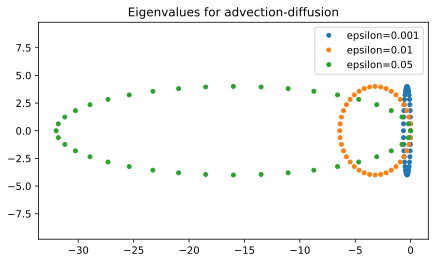

In [26]:
x,Dx,Dxx = FNC.diffper(40,[0,1]);
tau = 0.1
for ep in [0.001,0.01,0.05]:
    lamb = eigvals(-Dx + ep*Dxx)
    plot(real(tau*lamb),imag(tau*lamb),"o",label=f"epsilon={ep:.1g}")
axis("equal"); legend();
title("Eigenvalues for advection-diffusion");     

# Example 12.3.3

Deleting the first row and column places all the eigenvalues of the discretization into the left half of the complex plane. 

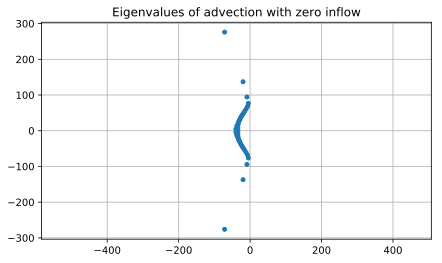

In [27]:
x,Dx,Dxx = FNC.diffcheb(40,[0,1]);
A = -Dx[1:,1:]     # leave out first row and column

lamb = eigvals(A)
plot(real(lamb),imag(lamb),"o")
xlim(-300,100); axis("equal"); grid(True);
title("Eigenvalues of advection with zero inflow"); 

Note that the rightmost eigenvalues have real part at most

In [28]:
max( real(lamb) )

-4.9319670358231935

Consequently all solutions decay exponentially to zero as $t\to\infty$. This matches the intuition of a flow with nothing at the inlet: eventually everything flows out of the domain. 

# Example 12.4.1

We solve the wave equation (in Maxwell form) for speed $c=2$, with homogeneous Dirichlet conditions on the first variable. 

In [29]:
m = 200
x,Dx,Dxx = FNC.diffmat2(m,[-1,1])

The boundary values of $u$ are given to be zero, so they are not unknowns in the ODEs we solve. Instead they are added or removed as necessary. 

In [30]:
trunc = lambda u: u[1:-1]
extend = lambda v: hstack([0,v,0])

The following function computes the time derivative of the system at interior points.

In [31]:
def dwdt(t,w):
    u = extend(w[:m-1])
    z = w[m-1:]
    dudt = Dx@z
    dzdt = c**2*(Dx@u)
    return hstack([ trunc(dudt), dzdt ])

Our initial condition is a single hump for $u$.

In [32]:
u_init = exp(-100*x**2)
z_init = -u_init
w_init = hstack([ trunc(u_init), z_init ])  

Because the wave equation is hyperbolic, we can use a nonstiff explicit solver.

In [33]:
c = 2
sol = solve_ivp(dwdt,(0,2),w_init,dense_output=True)

We plot the results for the original $u$ variable. 

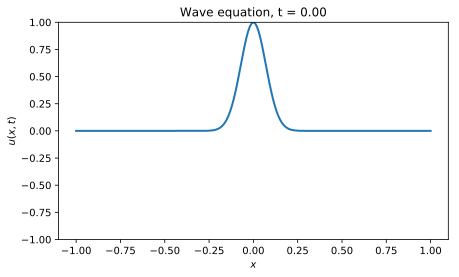

In [34]:
fig,ax = subplots();
curve = ax.plot(x,u_init)[0];
ax.set_xlabel("$x$"); ax.set_ylabel("$u(x,t)$");
ax.set_ylim(-1,1);

t = linspace(0,2,161)
def snapshot(j):
    u = extend( sol.sol(t[j])[:m-1] )
    curve.set_ydata(u);
    ax.set_title(f"Wave equation, t = {t[j]:.2f}");
FuncAnimation(fig,snapshot,frames=len(t))

The original hump breaks into two pieces of different amplitudes. Each travels with speed $c=2$, and they pass through one another without interference. When a hump encounters a boundary, it is perfectly reflected, but with inverted shape. At time $t=2$ the exact solution looks just like the initial condition.

# Example 12.4.2

We now use a wave speed that is discontinuous at $x=0$. 

In [35]:
m = 120
x,Dx,Dxx = FNC.diffcheb(m,[-1,1]);
c = 1 + (sign(x)+1)/2
trunc = lambda u: u[1:m]
extend = lambda v: hstack([0,v,0])

This function computes the time derivative of the method-of-lines system.

In [36]:
def dwdt(t,w):
    u = extend(w[:m-1])
    z = w[m-1:]
    dudt = Dx@z
    dzdt = c**2*(Dx@u)
    return hstack([ trunc(dudt), dzdt ])

We set the initial conditions and solve using |ode45|.

In [37]:
u_init = exp(-100*(x+0.5)**2)
z_init = -u_init
w_init = hstack([ trunc(u_init), z_init ])

sol = solve_ivp(dwdt,(0,5),w_init,dense_output=True,method="Radau")

At each time in the following animation, we evaluate the discrete solution for $u$ and then extend it to the boundaries using the boundary conditions. 

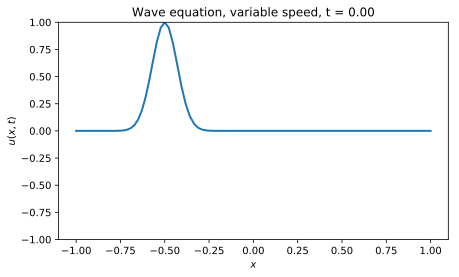

In [38]:
fig,ax = subplots();
curve = ax.plot(x,u_init)[0];
ax.set_xlabel("$x$"); ax.set_ylabel("$u(x,t)$");
ax.set_ylim(-1,1);

t = linspace(0,5,251)
def snapshot(j):
    u = extend( sol.sol(t[j])[:m-1] )
    curve.set_ydata(u);
    ax.set_title(f"Wave equation, variable speed, t = {t[j]:.2f}");
FuncAnimation(fig,snapshot,frames=len(t))

Each pass through the interface at $x=0$ generates a reflected and transmitted wave. By conservation of energy, these are both smaller in amplitude than the incoming bump. 